In [1]:
import os
import sys
from datetime import datetime
import scanpy as sc
import anndata as ad
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import importlib
import math
import json
import matplotlib.patches as patches

##
matplotlib.rcParams['pdf.fonttype'] = 42

## Helpful locations which are assumed to already exist
work_dir = f"/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Yuanyuan/Project/BGa/results/fig1" 
data_dir = f"/allen/programs/celltypes/workgroups/rnaseqanalysis/hct_ux3_cellxgene/anndata_080/BasalGanglia/Astro"
os.chdir(work_dir)

#adata = sc.read_h5ad(data_dir + "/HMBA_human_Astro_obs_Notes.h5ad")

/home/yuanyuan.fu/bin/miniconda3/envs/iterative_scANVI_May9/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/yuanyuan.fu/bin/miniconda3/envs/iterative_scANVI_May9/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/home/yuanyuan.fu/bin/miniconda3/envs/iterative_scANVI_May9/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_hdf from `anndata` is deprecated. Import anndata.io.read_hdf instead.
  warnings.warn(msg, FutureWarning)
/home/yuanyuan.fu/bin/miniconda3/envs/iterative_scANVI_May9/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/home/

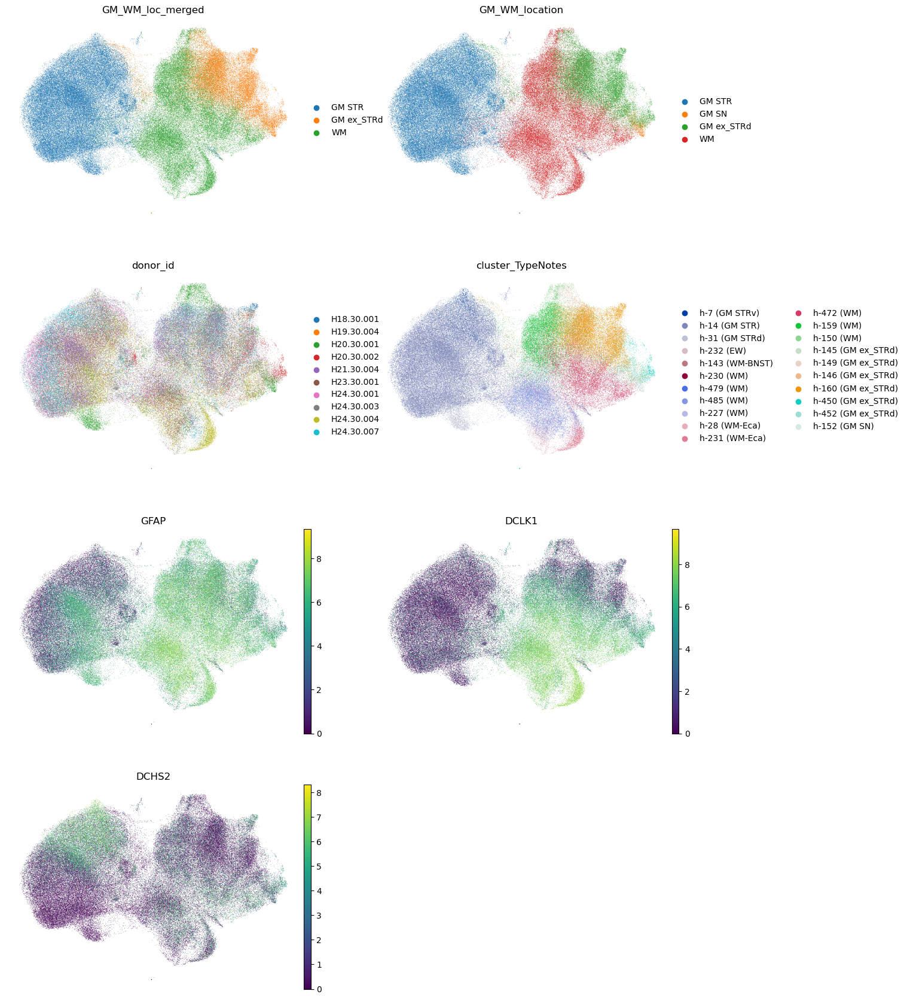

In [2]:
adata = sc.read_h5ad(os.path.join("/allen/programs/celltypes/workgroups/rnaseqanalysis/HMBA/Aim1_Atlases/Human/BasalGanglia/analysis/f1", f"Human_astro_newEmbedding_onlyAstroHVG06122025_128-10-1-1k.h5ad")) #data_dir

sc.pl.embedding(
    adata,
    use_raw=False,
    basis="X_umap",
    color=['GM_WM_loc_merged', 'GM_WM_location', 'donor_id', 'cluster_TypeNotes', 'GFAP', 'DCLK1', 'DCHS2'],
    frameon=False,
    ncols=2
)

In [3]:
adata

AnnData object with n_obs × n_vars = 136684 × 36601
    obs: 'Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster', 'cluster_id', 'cell_type_ontology_term', 'load_id', 'donor_id', 'assay', 'assay_ontology_term_id', 'organism', 'organism_ontology_term_id', 'development_stage', 'anatomical_region', 'anatomical_region_merged', 'anatomical_region_ontology_term_id', 'brain_region_ontology_term_id', 'self_reported_sex', 'self_reported_sex_ontology_term_id', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'disease', 'disease_ontology_term_id', 'suspension_type', 'is_primary_data', 'atac_confidently_mapped_read_pairs', 'atac_fraction_of_genome_in_peaks', 'atac_fraction_of_high_quality_fragments_in_cells', 'atac_fraction_of_high_quality_fragments_overlapping_tss', 'atac_fraction_of_high_quality_fragments_overlapping_peaks', 'atac_fraction_of_transposition_events_in_peaks_in_cells', 'atac_mean_raw_read_pairs_per_cell', 'atac_median_high_quality_fragments_per_cell', 'atac

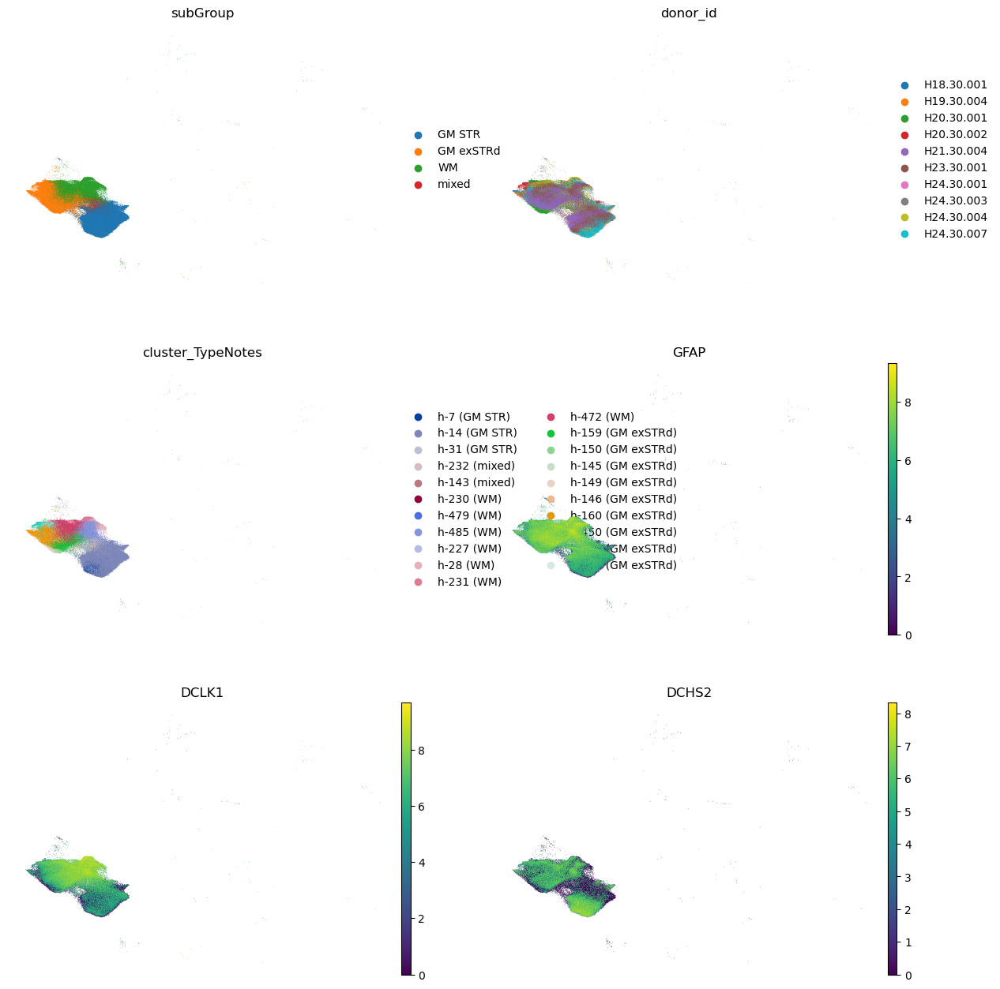

In [4]:
adata_notes = sc.read_h5ad(data_dir + "/HMBA_human_Astro_obs_Notes.h5ad")

sc.pl.embedding(
    adata_notes,
    use_raw=False,
    basis="X_umap",
    color=['subGroup', 'donor_id', 'cluster_TypeNotes', 'GFAP', 'DCLK1', 'DCHS2'],
    frameon=False,
    ncols=2
)

In [5]:
adata_notes

AnnData object with n_obs × n_vars = 136684 × 36601
    obs: 'Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster', 'cluster_id', 'cell_type_ontology_term', 'load_id', 'donor_id', 'assay', 'assay_ontology_term_id', 'organism', 'organism_ontology_term_id', 'development_stage', 'anatomical_region', 'anatomical_region_merged', 'anatomical_region_ontology_term_id', 'brain_region_ontology_term_id', 'self_reported_sex', 'self_reported_sex_ontology_term_id', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'disease', 'disease_ontology_term_id', 'suspension_type', 'is_primary_data', 'atac_confidently_mapped_read_pairs', 'atac_fraction_of_genome_in_peaks', 'atac_fraction_of_high_quality_fragments_in_cells', 'atac_fraction_of_high_quality_fragments_overlapping_tss', 'atac_fraction_of_high_quality_fragments_overlapping_peaks', 'atac_fraction_of_transposition_events_in_peaks_in_cells', 'atac_mean_raw_read_pairs_per_cell', 'atac_median_high_quality_fragments_per_cell', 'atac

In [6]:
# ---- 1) Check cell-id consistency and align order ----
cells_src = pd.Index(adata.obs_names)
cells_dst = pd.Index(adata_notes.obs_names)

missing_in_src = cells_dst.difference(cells_src)
missing_in_dst = cells_src.difference(cells_dst)

if len(missing_in_src) > 0 or len(missing_in_dst) > 0:
    # Not identical. Report and align to intersection so assignment is valid.
    print(f"[WARN] Cell IDs are not identical.")
    if len(missing_in_src) > 0:
        print(f" - Missing in `adata` (present in adata_Notes): {len(missing_in_src)}")
    if len(missing_in_dst) > 0:
        print(f" - Missing in `adata_Notes` (present in adata): {len(missing_in_dst)}")
    common = cells_dst.intersection(cells_src)
    if len(common) == 0:
        raise ValueError("No overlapping cell IDs between `adata` and `adata_Notes`.")
    # Reindex both to the same order (follow adata_Notes order within the common set)
    keep = cells_dst[cells_dst.isin(common)]
    adata_src_aln  = adata[keep, :].copy()
    adata_notes_aln = adata_Notes[keep, :].copy()
else:
    # Identical sets; make sure the source is in the same order as destination
    adata_src_aln  = adata[adata_notes.obs_names, :].copy()
    adata_notes_aln = adata_notes.copy()


In [7]:
# ---- SETTINGS ----
UMAP_SRC_KEY = 'X_umap'  
UMAP_DST_KEY = f'{UMAP_SRC_KEY}_consensus'  # will become 'X_umap_consensus'


# ---- 2) Backup current UMAP in adata_notes, then overwrite with adata's UMAP ----

# 2a) backup adata_Notes' existing UMAP into *_consensus
if UMAP_SRC_KEY in adata_notes_aln.obsm_keys():
    adata_notes_aln.obsm[UMAP_DST_KEY] = adata_notes_aln.obsm[UMAP_SRC_KEY].copy()
    print(f"[OK] Backed up adata_Notes.obsm['{UMAP_SRC_KEY}'] → ['{UMAP_DST_KEY}'].")
else:
    print(f"[INFO] adata_notes.obsm['{UMAP_SRC_KEY}'] not found; skip backup to '{UMAP_DST_KEY}'.")

# 2b) now transfer from `adata` → `adata_Notes` (overwrite)
if UMAP_SRC_KEY not in adata_src_aln.obsm_keys():
    raise KeyError(f"`{UMAP_SRC_KEY}` not found in `adata.obsm_keys()`.")
adata_notes_aln.obsm[UMAP_SRC_KEY] = adata_src_aln.obsm[UMAP_SRC_KEY].copy()

print(f"[OK] Transferred adata.obsm['{UMAP_SRC_KEY}'] → adata_notes.obsm['{UMAP_SRC_KEY}'] "
      f"for n={adata_notes_aln.n_obs} cells.")


[OK] Backed up adata_Notes.obsm['X_umap'] → ['X_umap_consensus'].
[OK] Transferred adata.obsm['X_umap'] → adata_notes.obsm['X_umap'] for n=136684 cells.


In [8]:
adata_notes_aln

AnnData object with n_obs × n_vars = 136684 × 36601
    obs: 'Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster', 'cluster_id', 'cell_type_ontology_term', 'load_id', 'donor_id', 'assay', 'assay_ontology_term_id', 'organism', 'organism_ontology_term_id', 'development_stage', 'anatomical_region', 'anatomical_region_merged', 'anatomical_region_ontology_term_id', 'brain_region_ontology_term_id', 'self_reported_sex', 'self_reported_sex_ontology_term_id', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'disease', 'disease_ontology_term_id', 'suspension_type', 'is_primary_data', 'atac_confidently_mapped_read_pairs', 'atac_fraction_of_genome_in_peaks', 'atac_fraction_of_high_quality_fragments_in_cells', 'atac_fraction_of_high_quality_fragments_overlapping_tss', 'atac_fraction_of_high_quality_fragments_overlapping_peaks', 'atac_fraction_of_transposition_events_in_peaks_in_cells', 'atac_mean_raw_read_pairs_per_cell', 'atac_median_high_quality_fragments_per_cell', 'atac

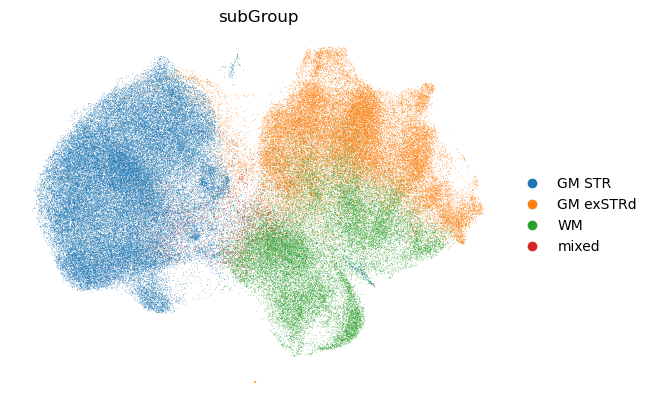

                              subGroup cluster
CACTAAGGTCATGCCC-2362_A05       GM STR     h-7
AAACAGCCATTGTGGC-2362_A05       GM STR    h-14
GATCGAGCATGATTGT-2349_C08       GM STR    h-31
AAACATGCAGTAGGAT-2362_A05    GM exSTRd   h-159
AGGATGCAGGTTAGCT-2362_A05    GM exSTRd   h-150
AACCGCTCAATATAGG-2362_A05    GM exSTRd   h-145
GATCAGGCACAATGCC-2362_A05    GM exSTRd   h-149
GTCTCACTCCCTGGTT-2433_1_G04  GM exSTRd   h-146
AAAGCGGGTCATCATC-2362_A05    GM exSTRd   h-160
TCACCGGCAGGCTTCG-2362_A05    GM exSTRd   h-450
AATTAGCGTGAACAAA-2362_A05    GM exSTRd   h-452
GCAAGTGCAAACCTTG-2370_B03    GM exSTRd   h-152
CAGCCTAAGTATTGGC-2386_A02           WM   h-230
TACTGGCCACTGACCG-2346_B06           WM   h-479
ACGGTTTAGGCGGATG-2362_A05           WM   h-485
AACCTAATCCTCACAC-2362_A05           WM   h-227
AAAGCCGCACCTAATG-2362_A05           WM    h-28
AGTAAGTAGCACCACA-2362_A05           WM   h-231
AGCTACTAGGCGCACT-2362_A05           WM   h-472
AGCACTTAGCACAGAA-2362_A05        mixed   h-232
CTGTACCTCATGC

In [9]:
sc.pl.embedding(
    adata_notes_aln,
    use_raw=False,
    basis="X_umap",
    color=['subGroup'],
    frameon=False,
    ncols=2,
)

mapping = (
    adata_notes_aln.obs[['subGroup', 'cluster']]
    .drop_duplicates()
    .sort_values(['subGroup', 'cluster'])
)

print(mapping)

In [10]:
# "GM exSTRd" → "GM exSTR"
adata_notes_aln.obs['subGroup'] = adata_notes_aln.obs['subGroup'].replace({"GM exSTRd": "GM exSTR"})


print(adata_notes_aln.obs['subGroup'].value_counts())


subGroup
GM STR      63839
GM exSTR    40540
WM          29745
mixed        2560
Name: count, dtype: int64


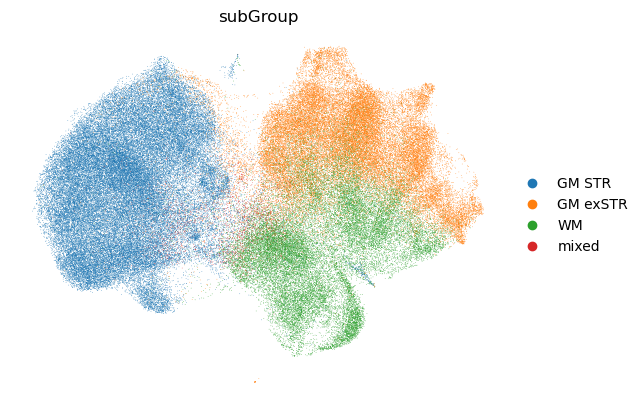

                             subGroup cluster
CACTAAGGTCATGCCC-2362_A05      GM STR     h-7
AAACAGCCATTGTGGC-2362_A05      GM STR    h-14
GATCGAGCATGATTGT-2349_C08      GM STR    h-31
AAACATGCAGTAGGAT-2362_A05    GM exSTR   h-159
AGGATGCAGGTTAGCT-2362_A05    GM exSTR   h-150
AACCGCTCAATATAGG-2362_A05    GM exSTR   h-145
GATCAGGCACAATGCC-2362_A05    GM exSTR   h-149
GTCTCACTCCCTGGTT-2433_1_G04  GM exSTR   h-146
AAAGCGGGTCATCATC-2362_A05    GM exSTR   h-160
TCACCGGCAGGCTTCG-2362_A05    GM exSTR   h-450
AATTAGCGTGAACAAA-2362_A05    GM exSTR   h-452
GCAAGTGCAAACCTTG-2370_B03    GM exSTR   h-152
CAGCCTAAGTATTGGC-2386_A02          WM   h-230
TACTGGCCACTGACCG-2346_B06          WM   h-479
ACGGTTTAGGCGGATG-2362_A05          WM   h-485
AACCTAATCCTCACAC-2362_A05          WM   h-227
AAAGCCGCACCTAATG-2362_A05          WM    h-28
AGTAAGTAGCACCACA-2362_A05          WM   h-231
AGCTACTAGGCGCACT-2362_A05          WM   h-472
AGCACTTAGCACAGAA-2362_A05       mixed   h-232
CTGTACCTCATGCTAA-960_B03        mi

In [11]:
sc.pl.embedding(
    adata_notes_aln,
    use_raw=False,
    basis="X_umap",
    color=['subGroup'],
    frameon=False,
    ncols=2,
)

mapping = (
    adata_notes_aln.obs[['subGroup', 'cluster']]
    .drop_duplicates()
    .sort_values(['subGroup', 'cluster'])
)

print(mapping)

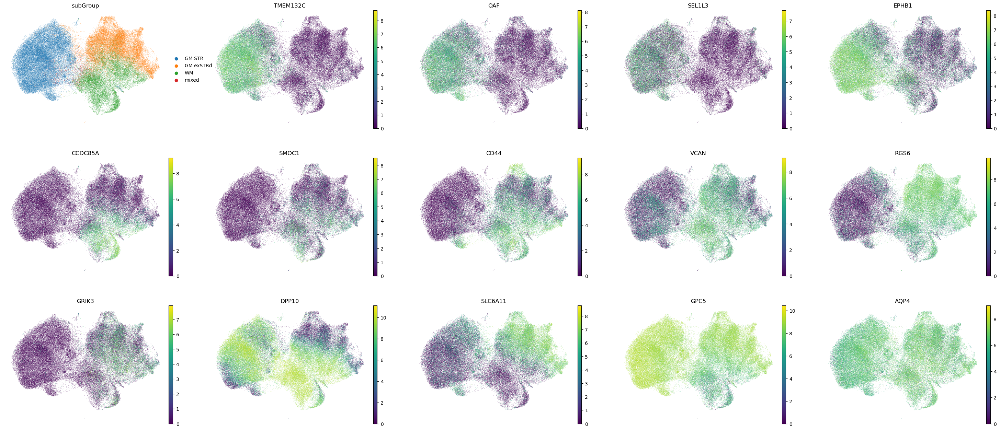

In [15]:
sc.settings.figdir = "./"   
sc.settings.dpi = 200  

sc.pl.embedding(
    adata_notes_aln,
    use_raw=False,
    basis="X_umap",
    color=['subGroup', 'TMEM132C', 'OAF','SEL1L3', 'EPHB1', 'CCDC85A', 'SMOC1', 'CD44', 'VCAN', 'RGS6', 'GRIK3', 'DPP10', 'SLC6A11', 'GPC5', 'AQP4'],
    frameon=False,
    ncols=5,
    save="Markers_inSpatialPanel_on_21clusters.pdf"
   # save="Markers_inSpatialPanel_on_21clusters.png"
)

In [12]:
clusters_to_plot = ['h-7', 'h-14', 'h-31', #GM STRv, STR, STRd
                    'h-145', 'h-150', 'h-149', 'h-146', 'h-160', 'h-450', 'h-452', 'h-152', 'h-159',#GM ex_STRd
                    'h-472', 'h-479', 'h-485', 'h-230', 'h-231', 'h-28',    #WM
                    'h-227', 'h-232', 'h-143', ] #everywhere, BNST-HTH? 
adata_notes_aln.obs['cluster'] = pd.Categorical([str(x) for x in adata_notes_aln.obs['cluster']], categories=clusters_to_plot, ordered=True)


subGroup_to_plot = ['GM STR', 'GM exSTR', 'WM', 'mixed'] 
adata_notes_aln.obs['subGroup'] = pd.Categorical([str(x) for x in adata_notes_aln.obs['subGroup']], categories=subGroup_to_plot, ordered=True)



adata_notes_aln.uns['subGroup_colors'] = ["#2B83BA", "#A6D854", "#E24A6F", "#D0D2D3"] 
adata_notes_aln.uns['cluster_colors'] = ["#6BC6D1", "#419ED9", "#3C64B1",
                               "#C2E76E", "#A3D977", "#388E3C", "#2E7D32", "#52C79F",  "#4DBD82","#76D7A6", "#6BAF46", "#7BCDA3",
                               "#F08080", "#E25478", "#C9316C",  "#F292B2", "#8E4E95","#C173AD", 
                               "#AC2E66", "#F9DDE5","#F2C3CE"
                              ]

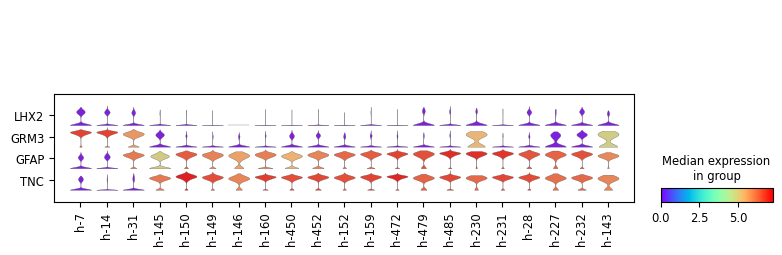

In [16]:
sc.pl.stacked_violin(
    adata_notes_aln, 
    ['LHX2', 'GRM3', 'GFAP', 'TNC'], 
    groupby='cluster', 
    use_raw=False, 
    swap_axes=True, 
    #figsize=(12,8),
    cmap='rainbow', #Blues
    dendrogram=False,
    save="Violinplot_of_LHX2-GRM3-GFAP-TNC_inAstroClusters.pdf"
)

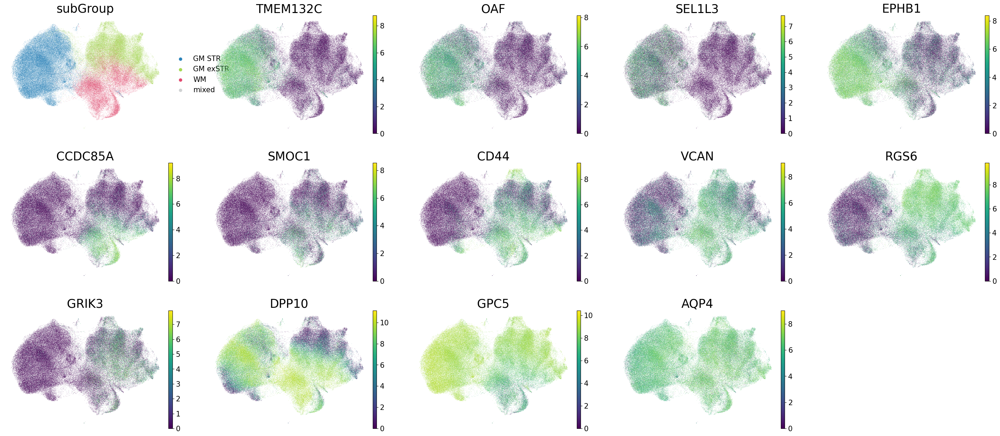

In [13]:
import matplotlib as mpl

#mpl.rcParams['font.family'] = 'Arial' #'DejaVu Sans' 
mpl.rcParams['font.size'] = 15   # expr. level      
mpl.rcParams['axes.titlesize'] = 25   # gene name font size  
mpl.rcParams['axes.labelsize'] = 9   
mpl.rcParams['legend.fontsize'] = 15    #GM STR etc


sc.settings.figdir = "./"   
sc.settings.dpi = 300  

sc.pl.embedding(
    adata_notes_aln,
    use_raw=False,
    basis="X_umap",
    color=['subGroup', 'TMEM132C', 'OAF','SEL1L3', 'EPHB1', 'CCDC85A', 'SMOC1', 'CD44', 'VCAN', 'RGS6', 'GRIK3', 'DPP10',  'GPC5', 'AQP4'], #'SLC6A11',
    frameon=False,
    ncols=5,
    save="Markers_inSpatialPanel_on_21clusters.png"
)


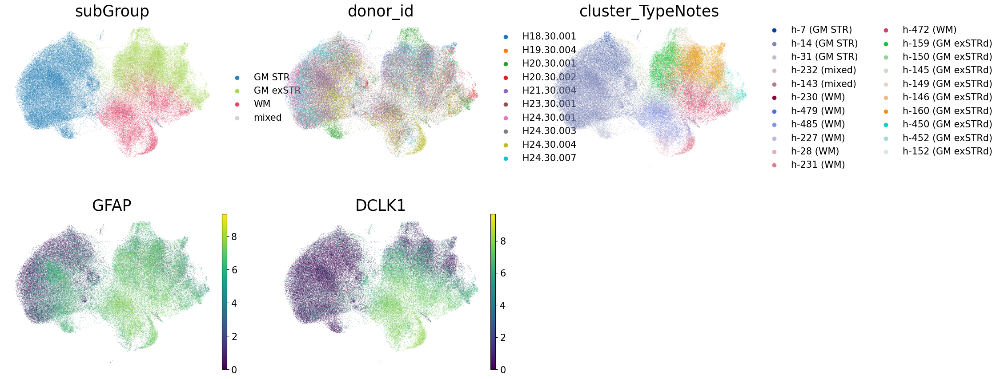

In [14]:
sc.pl.embedding(
    adata_notes_aln,
    use_raw=False,
    basis="X_umap", #"X_umap_consensus",
    color=['subGroup', 'donor_id', 'cluster_TypeNotes', 'GFAP', 'DCLK1'],
    frameon=False,
    ncols=3
)

In [28]:
### define plot_cluster function first on June 16

# install ALLCools: pip install git+https://github.com/DingWB/ALLCools.git
from ALLCools.plot import categorical_scatter

def plot_cluster(
	adata_path,ax=None,coord_base='X_umap',cluster_col='Cluster',
	palette_path=None,coding=True,output=None,
	show=True,figsize=(4, 3.5),sheet_name=None,
	ncol=None,fontsize=5,legend_fontsize=5,
	legend_kws=None,legend_title_fontsize=5,
	linewidth=0.5,axis_format='tiny',alpha=0.7,
	text_kws=None,**kwargs):
	"""
	Plot cluster.

	Parameters
	----------
	adata_path :
	ax :
	coord_base :
	cluster_col :
	palette_path :
	coding :
	output :
	show :
	figsize :
	sheet_name :
	ncol :
	fontsize :
	legend_fontsize :
	linewidth :
	kwargs : dict
		set text_anno=None to plot clustering without text annotations,
		coding=True to plot clustering without code annotations,
		set show_legend=False to remove the legend

	Returns
	-------

	"""
	if coord_base.startswith("X_"):
		coord_base=coord_base.replace('X_','')
	if sheet_name is None:
		sheet_name=cluster_col
	if isinstance(adata_path,str):
		adata=anndata.read_h5ad(adata_path,backed='r')
	else:
		adata=adata_path
	if not palette_path is None:
		if isinstance(palette_path,str):
			colors=pd.read_excel(os.path.expanduser(palette_path),sheet_name=sheet_name,index_col=0).Hex.to_dict()
			keys=list(colors.keys())
			existed_vals=adata.obs[cluster_col].unique().tolist()
			for k in existed_vals:
				if k not in keys:
					colors[k]='gray'
			for k in keys:
				if k not in existed_vals:
					del colors[k]
		else:
			colors=palette_path
		adata.uns[cluster_col + '_colors'] = [colors.get(k, 'grey') for k in adata.obs[cluster_col].cat.categories.tolist()]
	else:
		if f'{cluster_col}_colors' not in adata.uns:
			sc.pl.embedding(adata,basis=f"X_{coord_base}",color=[cluster_col])
		colors={cluster:color for cluster,color in zip(adata.obs[cluster_col].cat.categories.tolist(),adata.uns[f'{cluster_col}_colors'])}

	hue=cluster_col
	text_anno = cluster_col
	text_kws = {} if text_kws is None else text_kws
	default_text_kws = dict(color='white', fontweight="bold", fontsize=fontsize,
					bbox=dict(facecolor=colors, boxstyle='round',
							  edgecolor='white', fill=True, linewidth=linewidth, alpha=alpha))
	if coding:
		ct2code=adata.obs.assign(code=adata.obs[cluster_col].cat.codes).loc[:,[cluster_col,'code']].drop_duplicates().set_index(cluster_col).code.to_dict()
		id_colors={str(ct2code[cluster]):color for cluster,color in zip(adata.obs[cluster_col].cat.categories.tolist(),adata.uns[f'{cluster_col}_colors'])}
		colors={f"{ct2code[cluster]}: {cluster}":color for cluster,color in zip(adata.obs[cluster_col].cat.categories.tolist(),adata.uns[f'{cluster_col}_colors'])}
		adata.obs[f'code_{cluster_col}']=adata.obs[cluster_col].apply(lambda x:f"{ct2code[x]}: {x}")
		hue = f'code_{cluster_col}'
		text_anno = adata.obs[cluster_col].cat.codes.map(str)
		default_text_kws['bbox']['facecolor']=id_colors
		default_text_kws['bbox']['boxstyle'] = 'circle'
		# text_kws=dict(color='white',fontweight="bold",fontsize=fontsize,
		# 			 bbox=dict(facecolor=id_colors,boxstyle='circle', #ellipse, round
		# 					   edgecolor='white',fill=True,linewidth=linewidth,alpha=alpha))
	for k in default_text_kws:
		if k !='bbox':
			text_kws.setdefault(k, default_text_kws[k])
		else:
			if 'bbox' not in text_kws:
				text_kws['bbox']={}
			for k1 in default_text_kws['bbox']:
				text_kws['bbox'].setdefault(k1, default_text_kws['bbox'][k1])
	kwargs.setdefault("hue",hue)
	kwargs.setdefault("text_anno", text_anno)
	kwargs.setdefault("text_kws", text_kws)
	kwargs.setdefault("luminance", None) #0.48 colors of box and text -> black or white
	kwargs.setdefault("dodge_text", False)
	kwargs.setdefault("axis_format", axis_format)
	if ncol is None:
		ncol = 2 if adata.obs[cluster_col].nunique() > 40 else 1
	kwargs.setdefault("show_legend", True)
	legend_kws={} if legend_kws is None else legend_kws
	default_lgd_kws=dict(
		ncol=ncol, fontsize=legend_fontsize, loc='upper left',
		bbox_to_anchor=(1, 1),
		borderpad=0.4, # pad between marker (text) and border
		labelspacing=0.2, #The vertical space between the legend entries, in font-size units
		handleheight=0.5, #The height of the legend handles, in font-size units.
		handletextpad=0.2, # The pad between the legend handle (marker) and text, in font-size units.
		borderaxespad=0.2, # The pad between the Axes and legend border, in font-size units
		columnspacing=0.2, #The spacing between columns, in font-size units
		title=cluster_col,title_fontsize=legend_title_fontsize)
	for k in default_lgd_kws:
		legend_kws.setdefault(k, default_lgd_kws[k])
	kwargs.setdefault("dodge_kws", {
			"arrowprops": {
				"arrowstyle": "->",
				"fc": 'grey',
				"ec": "none",
				"connectionstyle": "angle,angleA=-90,angleB=180,rad=5",
			},
			'autoalign': 'xy'})
	if ax is None:
		fig, ax = plt.subplots(figsize=figsize, dpi=300)
	p = categorical_scatter(
		data=adata[adata.obs[cluster_col].notna(),],
		ax=ax,
		coord_base=coord_base,
		palette=colors,legend_kws=legend_kws,
		**kwargs)

	if not output is None:
		plt.savefig(os.path.expanduser(output),bbox_inches='tight',dpi=300)
	if show:
		plt.show()

# example usage 1:
#plot_cluster(adata_path=adata,coord_base=coord_base,cluster_col=clustering_name_annot,
#                 coding=True,palette_path=palette_path,ncol=1,
#                 output=f"{fig_basename}.annotated.{coord_base}.{clustering_name_annot}_with_code.pdf",
#                fontsize=4,# text_anno=None, legend_fontsize=3,dodge_text=True
#)

# example usage 2:
#plot_cluster(adata_path=adata,coord_base=coord_base,cluster_col=clustering_name_annot,
#             coding=False,palette_path=palette_path,ncol=1,
#             output=f"{fig_basename}.annotated.{coord_base}.{clustering_name_annot}.pdf",
#            text_anno=None)

# example usage 3:
#plot_cluster(
#            adata_path=adata,coord_base=coord_base,cluster_col=clustering_name_annot,
#            coding=False,palette_path=palette_path,ncol=1,show_legend=False,
#            output=f"{fig_basename}.annotated.{coord_base}.{clustering_name_annot}_with_text.pdf")


text_kws = dict(
    color='#333333', #'#2A3439',               # front color
    fontweight='normal', #'normal' bold,
    fontsize=5, #    fontfamily='Arial',
    bbox=dict(
        alpha=0.8,
        edgecolor='#FAFAFA',
        boxstyle='round,pad=0.15'
    )
)


palette_path={
    'cluster_color_map':{
        # GM STR (blue gradient)
        "h-7":  "#6BC6D1",  # light teal-blue
        "h-14": "#419ED9",  # medium blue
        "h-31": "#3C64B1",  # dark blue-gray

        # GM exSTR (green gradient)
        "h-145": "#C2E76E",  # lime green
        "h-150": "#A3D977",  # grass green
        "h-152": "#6BAF46",  # olive green (bridge)
        "h-159": "#7BCDA3",  # mint green
        "h-160": "#52C79F",  # jade green
        "h-149": "#388E3C",  # medium-deep leaf green
        "h-146": "#2E7D32",  # deep forest green
        "h-450": "#4DBD82",  # medium sea green (greenish cyan)
        "h-452": "#76D7A6",  # light seafoam green


        # WM (pink → red → purple gradient)
        "h-472": "#F08080",  # light coral red
        "h-230": "#F292B2",  # bubblegum pink
        "h-479": "#E25478",  # rose red
        "h-485": "#C9316C",  # magenta red
        "h-227": "#AC2E66",  # raspberry purple
        "h-28":  "#C173AD",  # purple rose
        "h-231": "#8E4E95",  # dark plum

        # Mixed (soft pinks)
        "h-232": "#F9DDE5",  # very light pink
        "h-143": "#F2C3CE",  # blush pink
    },

    'clusterTN_color_map':{
        "h-7 (GM STRv)":  "#6BC6D1",   # GM STRv - dark blue
        "h-14 (GM STR)": "#419ED9",   # GM STR - medium blue
        "h-31 (GM STRd)": "#3C64B1",   # GM STRd - blue-gray

        # GM ex_STRd series (green to orange)
        "h-145 (GM ex_STRd)": "#C2E76E",  # yellow-green (lime-like)
        "h-149 (GM ex_STRd)": "#A3D977",  # soft grass green
        "h-145 (GM ex_STRd)": "#7BCDA3",  # mint green
        "h-160 (GM ex_STRd)": "#52C79F",  # jade green
        "h-450 (GM ex_STRd)": "#40C3D9",  # cyan-teal
        "h-452 (GM ex_STRd)": "#8ADFE3",  # light cyan
        "h-152 (GM SN)": "#B06C00",  # GM SN - tangerine
        "h-159 (WM)": "#2E7D32",  # golden yellow (distinct from 152)
        "h-150 (WM)": "#388E3C",  # vivid orange (deeper than 152)
        
        # WM series (pink to red to purple)
        "h-230 (WM)": "#F292B2",  # WM - bubblegum pink
        "h-479 (WM)": "#E25478",  # WM - true rose
        "h-485 (WM)": "#C9316C",  # WM - magenta red
        "h-227 (WM)": "#AC2E66",  # WM - raspberry purple
        "h-28 (WM-Eca)":  "#C173AD",  # WM-Eca - purple rose
        "h-231 (WM-Eca)": "#8E4E95",  # WM-Eca - dark plum
        "h-472 (WM)": "#F08080",  # vibrant yellow (lemon-like)
        
        #mixed
        "h-232 (EW)": "#F9DDE5",  # EW - very light pink 
        "h-143": "#F2C3CE",  # WM-BNST - soft blush pink 

    },
    
    'region_color_map':{
        "Ca": "#3C64B1",
        "Eca": "#EB4C88",
        "GPe": "#7A4FB4",
        "GPi": "#C96AC4", 
        "NAC": "#6BC6D1",
        "Pu": "#419ED9",
        "SN-VTA": "#F89C5E", 
        "STH": "#B06C00", 
        "VeP": "#3DBE78",
    }, 

    'subGroup_color_map':{
        "GM STR": "#2B83BA",
        "GM exSTRd": "#A6D854",
        "WM": "#E24A6F",#, "#D0D2D3"
    }
}


/home/yuanyuan.fu/bin/miniconda3/envs/iterative_scANVI_May9/lib/python3.11/site-packages/matplotlib/patches.py:2894: RuntimeWarning: divide by zero encountered in scalar divide
  f2 = self.rad / d2
/home/yuanyuan.fu/bin/miniconda3/envs/iterative_scANVI_May9/lib/python3.11/site-packages/matplotlib/patches.py:2897: RuntimeWarning: invalid value encountered in scalar multiply
  (cx + dx2 * f2, cy + dy2 * f2)])
/home/yuanyuan.fu/bin/miniconda3/envs/iterative_scANVI_May9/lib/python3.11/site-packages/matplotlib/patches.py:2894: RuntimeWarning: divide by zero encountered in scalar divide
  f2 = self.rad / d2
/home/yuanyuan.fu/bin/miniconda3/envs/iterative_scANVI_May9/lib/python3.11/site-packages/matplotlib/patches.py:2897: RuntimeWarning: invalid value encountered in scalar multiply
  (cx + dx2 * f2, cy + dy2 * f2)])


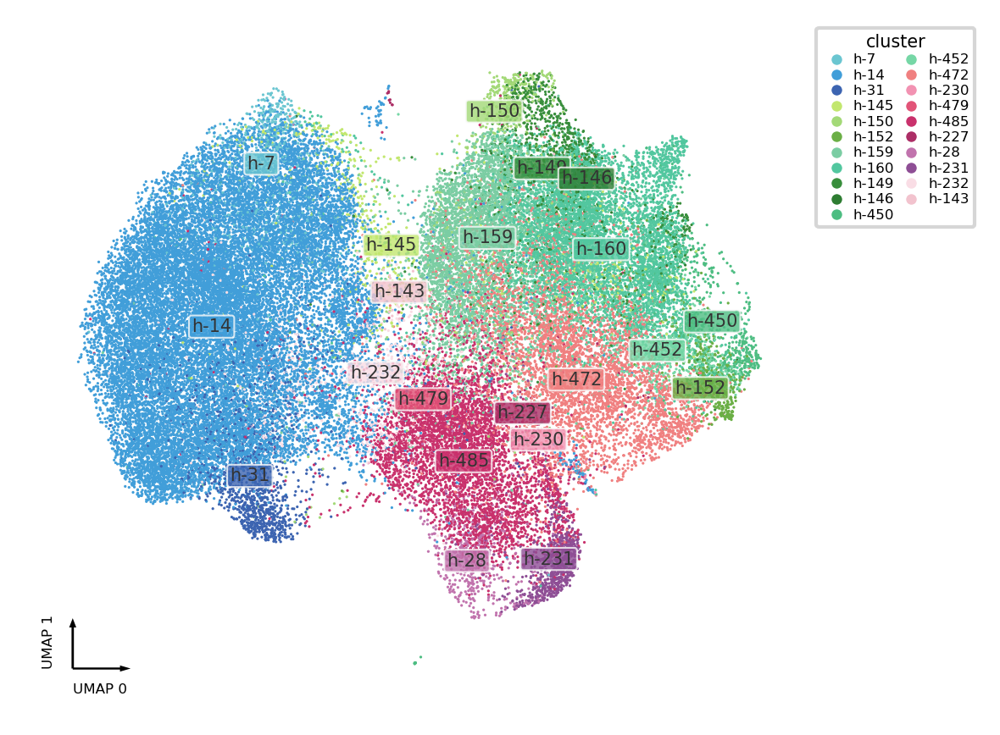

In [29]:
plot_cluster(adata_path=adata_notes_aln, coord_base='X_umap', cluster_col='cluster', text_anno='cluster', coding=False, 
            palette_path=palette_path['cluster_color_map'], ncol=2,
            fontsize=4, legend_fontsize=4, dodge_text=True, show_legend=True, text_kws=text_kws,
            output=f"Umap_astro_cluster.pdf",
)

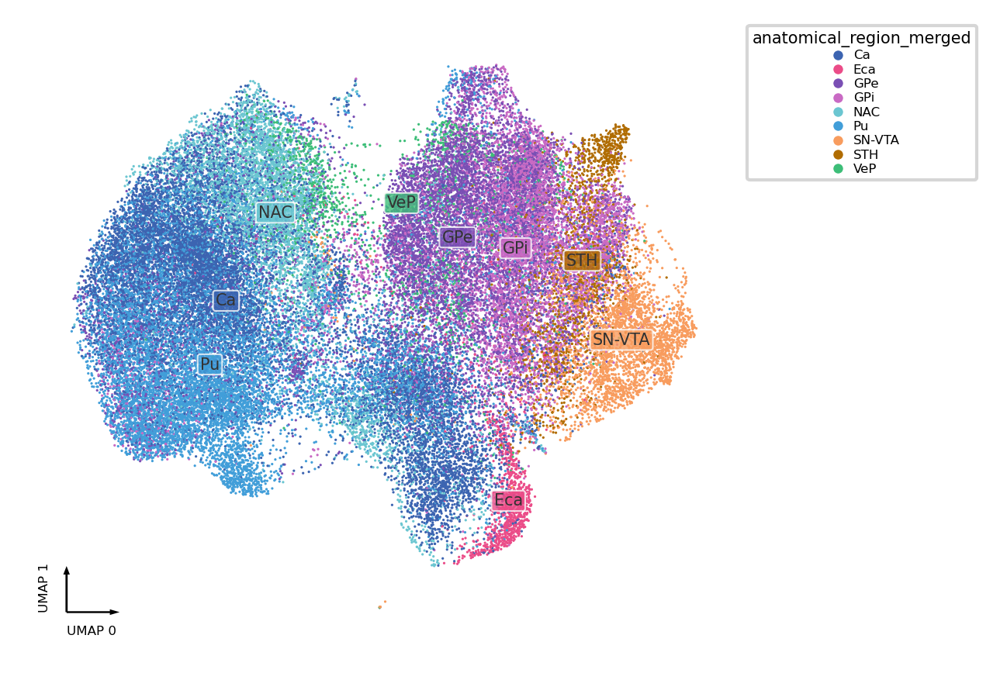

In [20]:
plot_cluster(adata_path=adata_notes_aln, coord_base='X_umap', cluster_col='anatomical_region_merged', text_anno='anatomical_region_merged', coding=False, 
            palette_path=palette_path['region_color_map'], ncol=1,
            fontsize=6, legend_fontsize=4, dodge_text=False, show_legend=True, text_kws=text_kws,
            output=f"Umap_astro_region.pdf",
)

In [18]:
set(adata_notes_aln.obs["anatomical_region_merged"])

{'Ca', 'Eca', 'GPe', 'GPi', 'NAC', 'Pu', 'SN-VTA', 'STH', 'VeP'}

In [ ]:
   'region_color_map':{
        "Ca": "#3C64B1",
        "Eca": "#EB4C88",
        "GPe": "#7A4FB4",
        "GPi": "#C96AC4", 
        "NAC": "#6BC6D1",
        "Pu": "#419ED9",
        "SN-VTA": "#F89C5E", ##D18E1D 
        "STH": "#B06C00", #"#F6A76E",
        "VeP": "#3DBE78", #", #"E875A8",    
    }, 

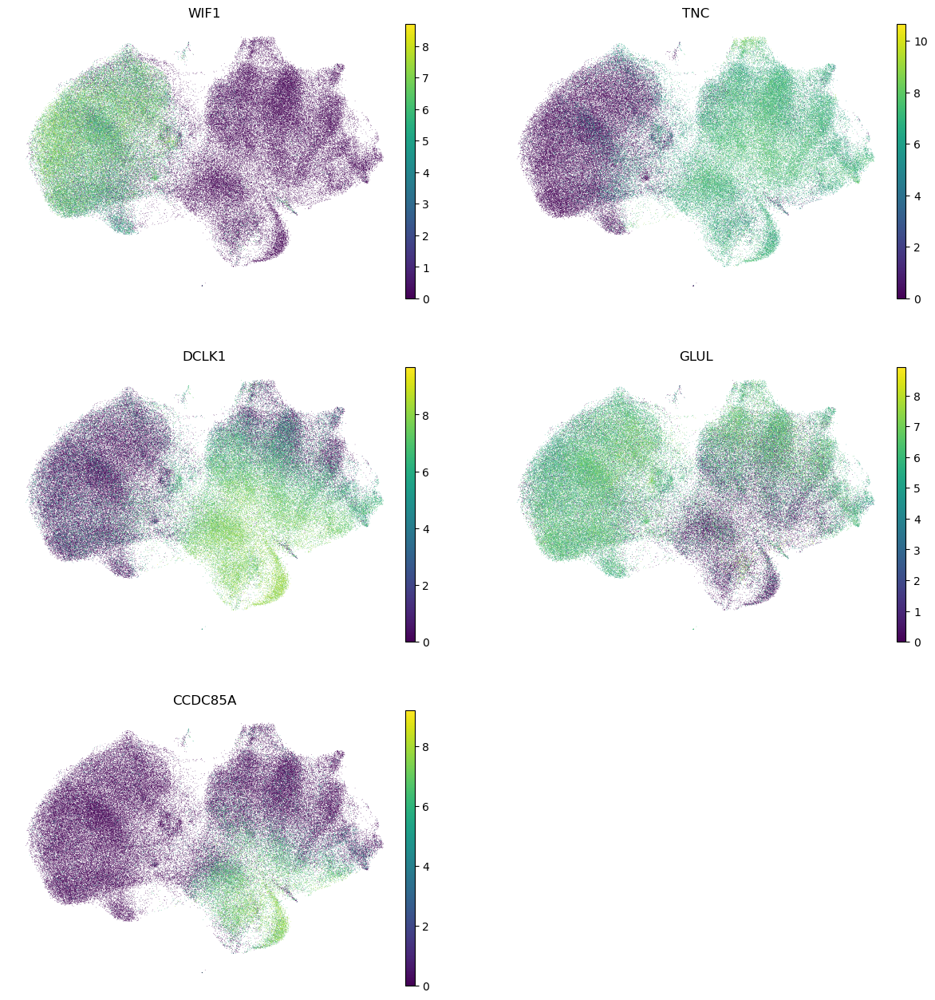

In [32]:
sc.settings.figdir = "./"   
sc.settings.dpi = 400  

sc.pl.embedding(
    adata_notes_aln,
    use_raw=False,
    basis="X_umap",
    color=['WIF1', 'TNC', 'DCLK1', 'GLUL', 'CCDC85A'],
    frameon=False,
    ncols=2,
    save="markers_on_21clusters.pdf"
)

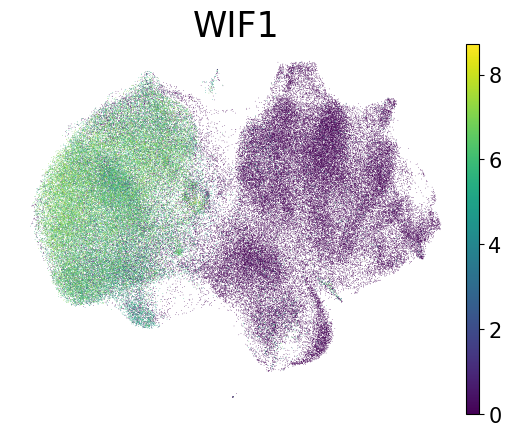

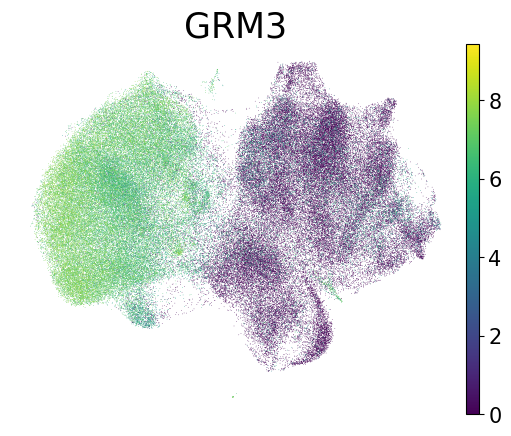

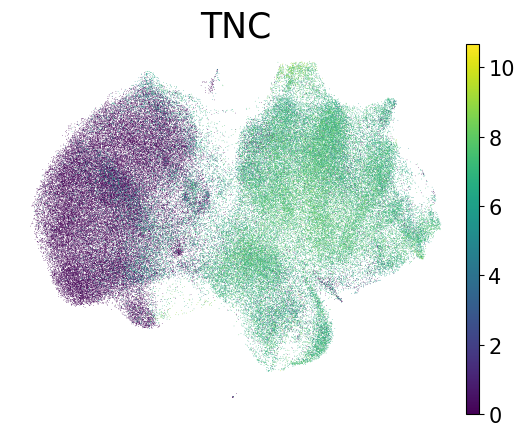

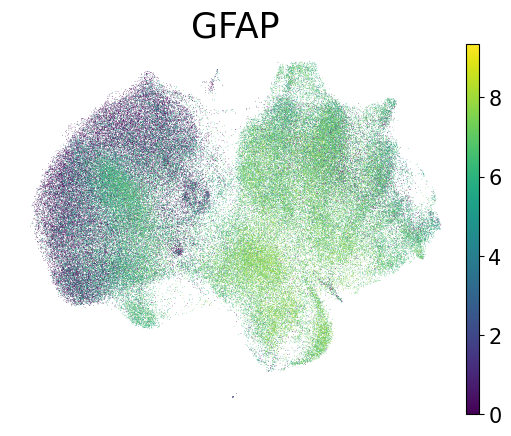

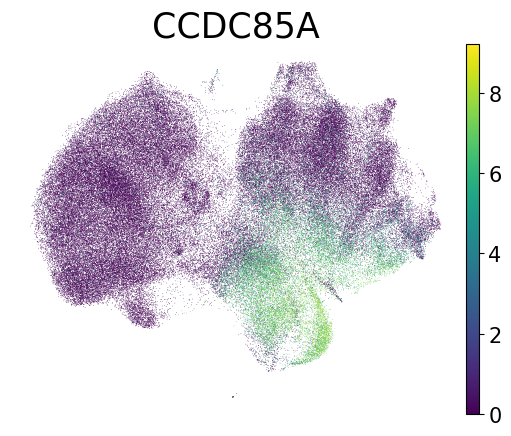

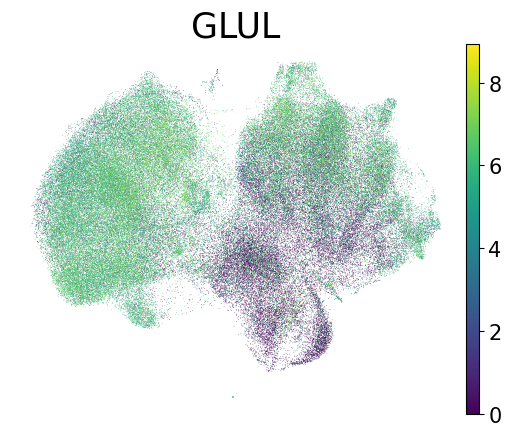

In [14]:
sc.pl.embedding(
    adata_notes_aln,
    basis="X_umap",
    use_raw=False,
    color=['WIF1'],
    frameon=False,
    ncols=2,
    save="WIF1_on_21clusters.png",                          
)

sc.pl.embedding(
    adata_notes_aln,
    basis="X_umap",
    use_raw=False,
    color=['GRM3'],
    frameon=False,
    ncols=2,
    save="GRM3_on_21clusters.png",                          
)

sc.pl.embedding(
    adata_notes_aln,
    basis="X_umap",
    use_raw=False,
    color=['TNC'],
    frameon=False,
    ncols=2,
    save="TNC_on_21clusters.png",                          
)


sc.pl.embedding(
    adata_notes_aln,
    basis="X_umap",
    use_raw=False,
    color=['GFAP'],
    frameon=False,
    ncols=2,
    save="GFAP_on_21clusters.png",                          
)


sc.pl.embedding(
    adata_notes_aln,
    basis="X_umap",
    use_raw=False,
    color=['CCDC85A'],
    frameon=False,
    ncols=2,
    save="CCDC85A_on_21clusters.png",                          
)

sc.pl.embedding(
    adata_notes_aln,
    basis="X_umap",
    use_raw=False,
    color=['GLUL'],
    frameon=False,
    ncols=2,
    save="GLUL_on_21clusters.png",                          
)


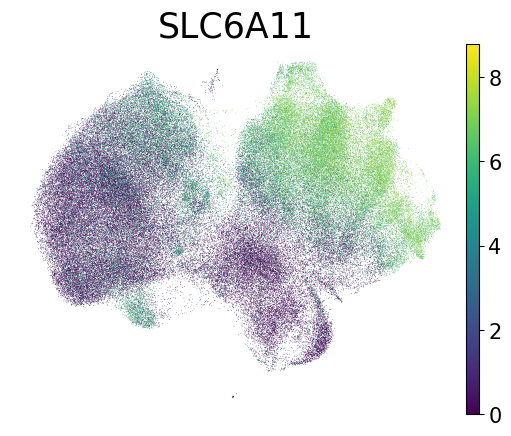

In [15]:
sc.pl.embedding(
    adata_notes_aln,
    basis="X_umap",
    use_raw=False,
    color=['SLC6A11'],
    frameon=False,
    ncols=2,
    save="SLC6A11_on_21clusters.png",                          
)

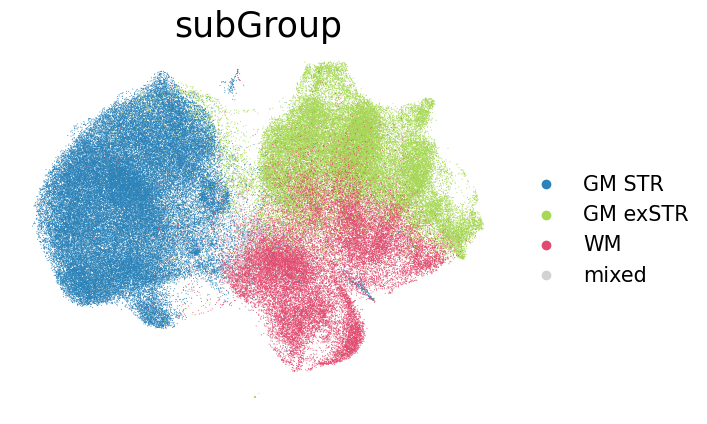

In [19]:
sc.pl.embedding(
    adata_notes_aln,
    basis="X_umap",
    use_raw=False,
    color=['subGroup'],
    frameon=False,
    ncols=2,
    size=2, 
    save="subGroup_on_21clusters.pdf",                          
)

In [10]:
set(adata_notes_aln.obs['cluster'])

{'h-14',
 'h-143',
 'h-145',
 'h-146',
 'h-149',
 'h-150',
 'h-152',
 'h-159',
 'h-160',
 'h-227',
 'h-230',
 'h-231',
 'h-232',
 'h-28',
 'h-31',
 'h-450',
 'h-452',
 'h-472',
 'h-479',
 'h-485',
 'h-7'}

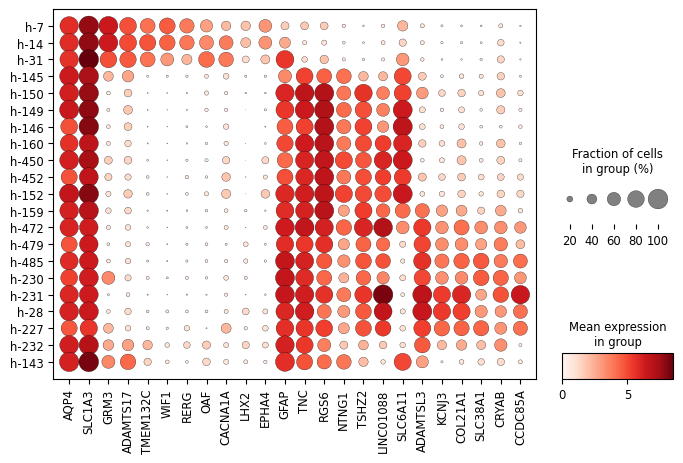

In [34]:
#genes_to_plot = ["SYT1", "TH", "SLC17A6", "SLC17A7"]  
gene_set1_to_plot = ['AQP4', 'SLC1A3', #'ALDH1L1', 
                     'GRM3', 'ADAMTS17', 'TMEM132C', 'WIF1', 'RERG', 'OAF', 'CACNA1A', 'LHX2', 'EPHA4',  #'ADGRV1', 'EPHA6', 'EPHB1',
                     'GFAP', 'TNC', 'RGS6', 'NTNG1', 'TSHZ2', 'LINC01088',  'SLC6A11', 'ADAMTSL3', 'KCNJ3', 'COL21A1', 'SLC38A1',  #'DCLK1', 'LUZP2', 'SLC24A4','GRIK3', 'SRPX',
                     'CRYAB', 'CCDC85A'] # , 'LMO2', 'SNAP25', 'SYT1', 'SLC18A2''SLC6A11', 

sc.pl.dotplot(
    adata_notes_aln,
    var_names=gene_set1_to_plot,
    groupby="cluster",  
    use_raw=False,
    dendrogram=False,
    standard_scale=None,  # None or "var"; Optional: normalize expression per gene
    dot_max=None,
    dot_min=None, 
    show=True,
    swap_axes=False,
    figsize=(8,4.8),
    save="dotplot_gene_set1_in_HMBAhumanAstro.pdf"
)

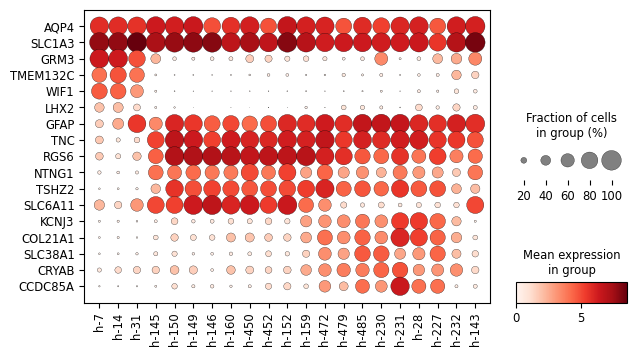

In [41]:
matplotlib.rcParams['pdf.fonttype'] = 42
#genes_to_plot = ["SYT1", "TH", "SLC17A6", "SLC17A7"]  
gene_set1_to_plot = ['AQP4', 'SLC1A3', #'ALDH1L1', 
                     'GRM3', 'TMEM132C', 'WIF1', 'LHX2',  #'ADGRV1', 'EPHA6', 'EPHB1',
                     'GFAP', 'TNC', 'RGS6', 'NTNG1', 'TSHZ2',  'SLC6A11', 'KCNJ3', 'COL21A1', 'SLC38A1',  #'DCLK1', 'LUZP2', 'SLC24A4','GRIK3', 'SRPX',
                     'CRYAB', 'CCDC85A'] # , 'LMO2', 'SNAP25', 'SYT1', 'SLC18A2''SLC6A11', 

sc.pl.dotplot(
    adata_notes_aln,
    var_names=gene_set1_to_plot,
    groupby="cluster",  
    use_raw=False,
    dendrogram=False,
    standard_scale=None,  # None or "var"; Optional: normalize expression per gene
    dot_max=None,
    dot_min=None, 
    show=True,
    swap_axes=True,
    figsize=(7,3.8),
    save="dotplot_gene_set1_in_HMBAhumanAstro.pdf"
)

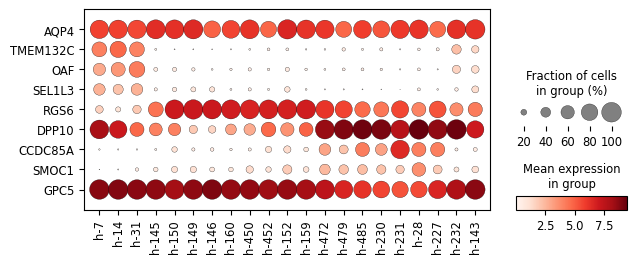

In [16]:
matplotlib.rcParams['pdf.fonttype'] = 42
#genes_to_plot = ["SYT1", "TH", "SLC17A6", "SLC17A7"]  
gene_set1_to_plot = ['AQP4', 
                     'TMEM132C', 'OAF', 'SEL1L3',# 'EPHB1',  #'ADGRV1', 
                     'RGS6',  #'GRIK3', 
                     'DPP10',
                     'CCDC85A', 'SMOC1', # 'CD44', 'VCAN', 
                     'GPC5',#'DCLK1', 'LUZP2', 'SLC24A4','GRIK3', 'SRPX',
                     ] # , 'LMO2', 'SNAP25', 'SYT1', 'SLC18A2''SLC6A11', 

sc.pl.dotplot(
    adata_notes_aln,
    var_names=gene_set1_to_plot,
    groupby="cluster",  
    use_raw=False,
    dendrogram=False,
    standard_scale=None,  # None or "var"; Optional: normalize expression per gene
    dot_max=None,
    dot_min=None, 
    show=True,
    swap_axes=True,
    figsize=(7,2.6),
    save="dotplot_gene_set1_in_HMBAhumanAstro.pdf"
)

In [17]:
adata_notes_aln.obs['subGroup'].value_counts()

subGroup
GM STR       63839
GM exSTRd    40540
WM           29745
mixed         2560
Name: count, dtype: int64

#### genes in whole BG taxonomy (Violin per subClass)

In [2]:
import os
import sys
from datetime import datetime
import scanpy as sc
import anndata as ad
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import importlib
import math
import json

##

## Helpful locations which are assumed to already exist
work_dir = f"/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Yuanyuan/Project/BGa/results/fig1" 
data_dir = f"/allen/programs/celltypes/workgroups/rnaseqanalysis/hct_ux3_cellxgene/anndata_080/BasalGanglia/Astro/../BICAN-releases/final"
os.chdir(work_dir)

adata_bg = sc.read_h5ad(data_dir + "/Human_HMBA_basalganglia_AIT_pre-print.h5ad")

In [4]:
set(adata_bg.obs['Subclass'])

{'ACx MEIS2 GABA',
 'Astrocyte',
 'CN Cholinergic GABA',
 'CN GABA-Glut',
 'CN LAMP5-CXCL14 GABA',
 'CN LAMP5-LHX6 GABA',
 'CN LHX8 GABA',
 'CN MEIS2 GABA',
 'CN ONECUT1 GABA',
 'CN ST18 GABA',
 'CN VIP GABA',
 'COP',
 'Endo',
 'Ependymal',
 'F GABA',
 'F Glut',
 'F M GATA3 GABA',
 'F M Glut',
 'Lymphocyte',
 'M Dopa',
 'Macrophage',
 'Microglia',
 'Monocyte',
 'OPC',
 'OT Granular GABA',
 'Oligodendrocyte',
 'Pericyte',
 'SMC',
 'SN PAX7 GABA',
 'STR D1 MSN',
 'STR D2 MSN',
 'STR Hybrid MSN',
 'STR RSPO2 GABA',
 'STR SST GABA',
 'STR SST-CHODL GABA',
 'VLMC'}

In [5]:
set(adata_bg.obs['display_order_group'])

{1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62}

In [9]:
len(subclass_order)

36

In [3]:
# --- 1) Build the subClass order from display_order_group (unique, order-preserving)
adata_bg.obs['display_order_group'] = adata_bg.obs['display_order_group'].astype('category')
group_to_subclass = (
    adata_bg.obs[['display_order_group', 'Subclass']]
    .drop_duplicates()
    .set_index('display_order_group')['Subclass']
)

group_order = list(adata_bg.obs['display_order_group'].cat.categories)

subclass_order = []
seen = set()
for g in group_order:
    scname = group_to_subclass[g]
    if scname not in seen:
        subclass_order.append(scname)
        seen.add(scname)

# Keep only categories that actually exist in the object
present = pd.Index(adata_bg.obs['Subclass'].unique())
subclass_order = [c for c in subclass_order if c in present]
print(subclass_order)

# --- 2) Set subClass as ordered categorical by that order
adata_bg.obs['Subclass'] = pd.Categorical(adata_bg.obs['Subclass'],
                                          categories=subclass_order,
                                          ordered=True)


['Astrocyte', 'Ependymal', 'Microglia', 'Macrophage', 'Lymphocyte', 'Monocyte', 'Oligodendrocyte', 'OPC', 'COP', 'Endo', 'Pericyte', 'SMC', 'VLMC', 'F Glut', 'F M Glut', 'M Dopa', 'CN LAMP5-LHX6 GABA', 'CN ST18 GABA', 'STR SST-CHODL GABA', 'STR SST GABA', 'STR RSPO2 GABA', 'CN Cholinergic GABA', 'CN LAMP5-CXCL14 GABA', 'CN VIP GABA', 'CN LHX8 GABA', 'CN ONECUT1 GABA', 'F M GATA3 GABA', 'SN PAX7 GABA', 'F GABA', 'CN MEIS2 GABA', 'STR D1 MSN', 'STR D2 MSN', 'STR Hybrid MSN', 'OT Granular GABA', 'ACx MEIS2 GABA', 'CN GABA-Glut']


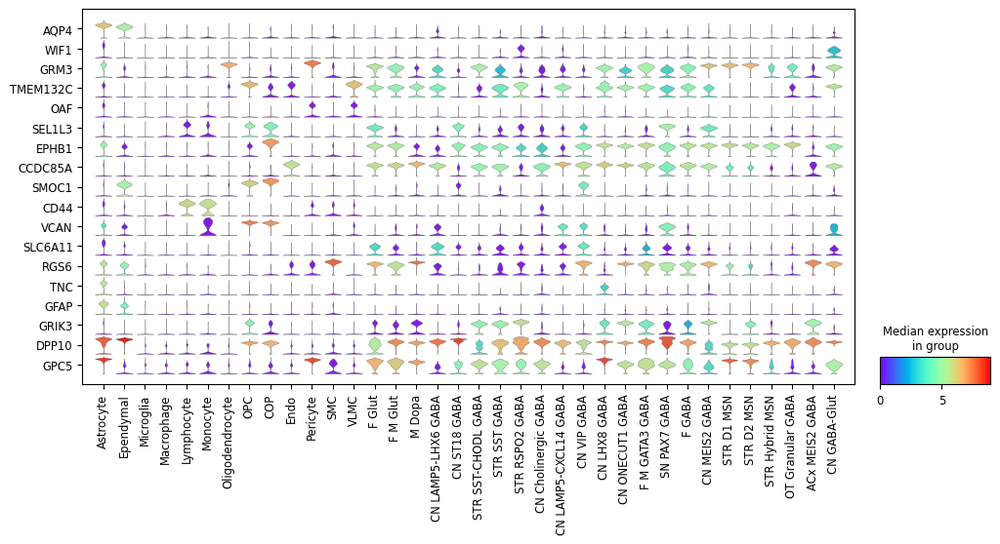

In [4]:
# --- 3) Violin plot for genes of interest
matplotlib.rcParams['pdf.fonttype'] = 42

genes = ['AQP4', 'WIF1', 'GRM3','TMEM132C', 'OAF', 'SEL1L3', 'EPHB1', 'CCDC85A', 'SMOC1', 'CD44', 'VCAN', 'SLC6A11','RGS6', 'TNC', 'GFAP', 'GRIK3', 'DPP10', 'GPC5']  
sc.pl.stacked_violin(
    adata_bg, 
    genes, 
    groupby='Subclass', 
    use_raw=False, 
    swap_axes=True, 
    figsize=(12,5),
    cmap='rainbow', #Blues
    dendrogram=False,
    save="Violinplot_of_SpatialGenes_in_HMBAhumanBGTaxo.pdf"
)

### QC plots for supp 1

In [15]:
adata_notes_aln

AnnData object with n_obs × n_vars = 136684 × 36601
    obs: 'Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster', 'cluster_id', 'cell_type_ontology_term', 'load_id', 'donor_id', 'assay', 'assay_ontology_term_id', 'organism', 'organism_ontology_term_id', 'development_stage', 'anatomical_region', 'anatomical_region_merged', 'anatomical_region_ontology_term_id', 'brain_region_ontology_term_id', 'self_reported_sex', 'self_reported_sex_ontology_term_id', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'disease', 'disease_ontology_term_id', 'suspension_type', 'is_primary_data', 'atac_confidently_mapped_read_pairs', 'atac_fraction_of_genome_in_peaks', 'atac_fraction_of_high_quality_fragments_in_cells', 'atac_fraction_of_high_quality_fragments_overlapping_tss', 'atac_fraction_of_high_quality_fragments_overlapping_peaks', 'atac_fraction_of_transposition_events_in_peaks_in_cells', 'atac_mean_raw_read_pairs_per_cell', 'atac_median_high_quality_fragments_per_cell', 'atac

In [19]:
set(adata_notes_aln.obs['cluster'])

{'h-14',
 'h-143',
 'h-145',
 'h-146',
 'h-149',
 'h-150',
 'h-152',
 'h-159',
 'h-160',
 'h-227',
 'h-230',
 'h-231',
 'h-232',
 'h-28',
 'h-31',
 'h-450',
 'h-452',
 'h-472',
 'h-479',
 'h-485',
 'h-7'}

In [18]:
adata = adata_notes_aln

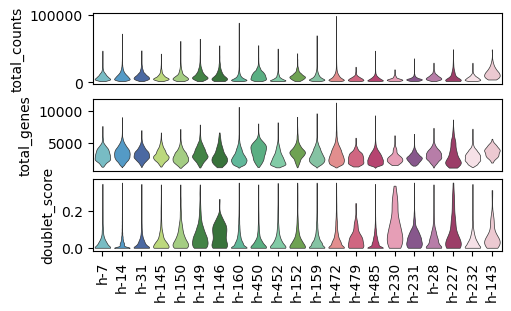

In [21]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)

qc_metrics = ['total_counts', 'total_genes', 'doublet_score']
group_col = 'cluster'

fig, axes = plt.subplots(
    nrows=3, ncols=1, figsize=(5, 3), 
    constrained_layout=True
)

for i, metric in enumerate(qc_metrics):
    sc.pl.violin(
        adata,
        keys=metric,
        groupby=group_col,
        jitter=True,
        size=0.01,
        stripplot=True,
        ax=axes[i],
        show=False,
        rotation=90,
        linewidth=0.5,
    )
    if i < len(qc_metrics) - 1:
        axes[i].set_xlabel("")
        axes[i].set_xticklabels([])
        axes[i].tick_params(axis='x', which='both', length=0)

plt.savefig("QC_violin_cluster.png", dpi=300, bbox_inches='tight')
plt.show()


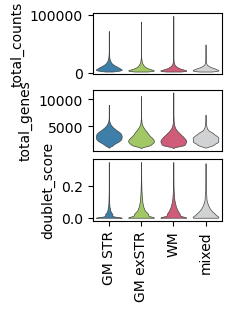

In [22]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)


qc_metrics = ['total_counts', 'total_genes', 'doublet_score']
group_col = 'subGroup'

fig, axes = plt.subplots(
    nrows=3, ncols=1, figsize=(2.2, 3), 
    constrained_layout=True
)

for i, metric in enumerate(qc_metrics):
    sc.pl.violin(
        adata,
        keys=metric,
        groupby=group_col,
        jitter=True,
        size=0.01,
        stripplot=True,
        ax=axes[i],
        show=False,
        rotation=90,
        linewidth=0.5,
    )
    if i < len(qc_metrics) - 1:
        axes[i].set_xlabel("")
        axes[i].set_xticklabels([])
        axes[i].tick_params(axis='x', which='both', length=0)

plt.savefig("QC_violin_subGroup.png", dpi=300, bbox_inches='tight')
plt.show()


In [23]:
adata_notes_aln.obs['subGroup'].value_counts()

subGroup
GM STR      63839
GM exSTR    40540
WM          29745
mixed        2560
Name: count, dtype: int64

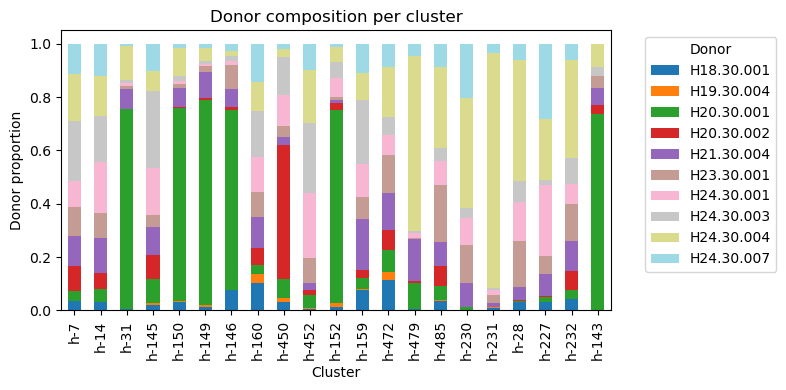

In [40]:
# Step 1: Calculate region proportions within each donor
matplotlib.rcParams['pdf.fonttype'] = 42

region_prop = (
    adata.obs.groupby(['cluster', 'donor_id'])
    .size()
    .groupby(level=0)
    .apply(lambda x: x / x.sum())
    .unstack(fill_value=0)
)

# Step 1.5: Ensure x-axis is not tuple-like
region_prop.index = region_prop.index.get_level_values(0)

# Step 2: Plot stacked bar chart
region_prop.plot(
    kind='bar',
    stacked=True,
    figsize=(8, 4),
    colormap='tab20'  # You can change to e.g. 'Set3', 'Paired', 'Pastel1' etc.
)

# Step 3: Formatting
plt.ylabel('Donor proportion')
plt.xlabel('Cluster')
plt.title('Donor composition per cluster')
plt.legend(title='Donor', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig("Donor_composition_per_cluster.pdf", dpi=300)
plt.show()


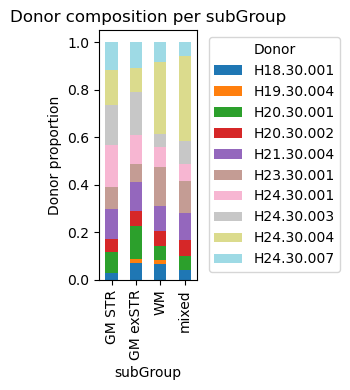

In [24]:
# Step 1: Calculate region proportions within each donor
region_prop = (
    adata.obs.groupby(['subGroup', 'donor_id'])
    .size()
    .groupby(level=0)
    .apply(lambda x: x / x.sum())
    .unstack(fill_value=0)
)

# Step 1.5: Ensure x-axis is not tuple-like
region_prop.index = region_prop.index.get_level_values(0)

# Step 2: Plot stacked bar chart
region_prop.plot(
    kind='bar',
    stacked=True,
    figsize=(3.3, 4),
    colormap='tab20'  # You can change to e.g. 'Set3', 'Paired', 'Pastel1' etc.
)

# Step 3: Formatting
plt.ylabel('Donor proportion')
plt.xlabel('subGroup')
plt.title('Donor composition per subGroup')
plt.legend(title='Donor', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig("Donor_composition_per_subGroup.pdf", dpi=300)
plt.show()


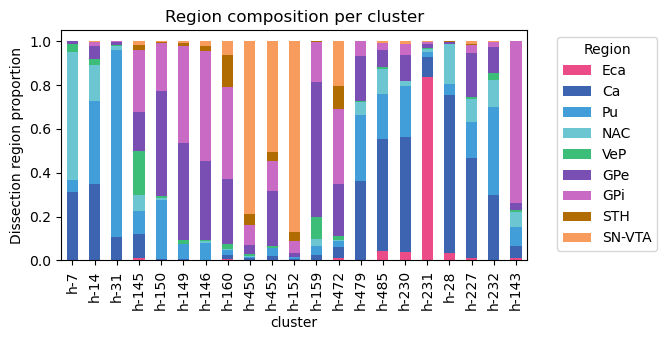

In [46]:
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Calculate region proportions within each subGroup
region_prop = (
    adata.obs.groupby(['cluster', 'anatomical_region_merged'])
    .size()
    .groupby(level=0)
    .apply(lambda x: x / x.sum())
    .unstack(fill_value=0)
)

desired_region_order = ["Eca", "Ca", "Pu", "NAC", "VeP", "GPe", "GPi", "STH", "SN-VTA"]
region_prop = region_prop[desired_region_order]


# Step 2: Define region color mapping
region_color_map = {
    "Ca": "#3C64B1",
    "Eca": "#EB4C88",
    "GPe": "#7A4FB4",
    "GPi": "#C96AC4", 
    "NAC": "#6BC6D1",
    "Pu": "#419ED9",
    "SN-VTA": "#F89C5E",
    "STH": "#B06C00",
    "VeP": "#3DBE78"
}

region_prop.index = region_prop.index.get_level_values(0)
# Make sure the color list matches column order
colors = [region_color_map.get(region, "#CCCCCC") for region in desired_region_order]

# Step 3: Plot
region_prop.plot(
    kind='bar',
    stacked=True,
    figsize=(6.8, 3.5),
    color=colors
)

# Step 4: Formatting
plt.ylabel('Dissection region proportion')
plt.xlabel('cluster')
plt.title('Region composition per cluster')
plt.legend(title='Region', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig("Region_composition_per_cluster.pdf", dpi=300)
plt.show()


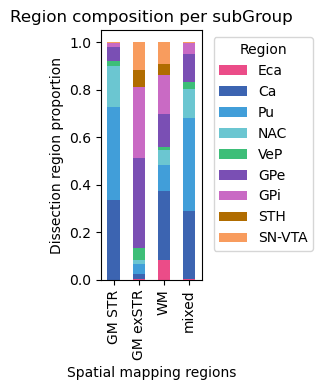

In [25]:
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Calculate region proportions within each subGroup
region_prop = (
    adata.obs.groupby(['subGroup', 'anatomical_region_merged'])
    .size()
    .groupby(level=0)
    .apply(lambda x: x / x.sum())
    .unstack(fill_value=0)
)

desired_region_order = ["Eca", "Ca", "Pu", "NAC", "VeP", "GPe", "GPi", "STH", "SN-VTA"]
region_prop = region_prop[desired_region_order]


# Step 2: Define region color mapping
region_color_map = {
    "Ca": "#3C64B1",
    "Eca": "#EB4C88",
    "GPe": "#7A4FB4",
    "GPi": "#C96AC4", 
    "NAC": "#6BC6D1",
    "Pu": "#419ED9",
    "SN-VTA": "#F89C5E",
    "STH": "#B06C00",
    "VeP": "#3DBE78"
}

region_prop.index = region_prop.index.get_level_values(0)
# Make sure the color list matches column order
colors = [region_color_map.get(region, "#CCCCCC") for region in desired_region_order]

# Step 3: Plot
region_prop.plot(
    kind='bar',
    stacked=True,
    figsize=(3, 4),
    color=colors
)

# Step 4: Formatting
plt.ylabel('Dissection region proportion')
plt.xlabel('Spatial mapping regions')
plt.title('Region composition per subGroup')
plt.legend(title='Region', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig("Region_composition_per_subGroup.pdf", dpi=300)
plt.show()


In [47]:
adata.obs['cluster'].value_counts()

cluster
h-14     58596
h-160    17037
h-485    12908
h-472    12864
h-159    12053
h-31      3350
h-149     2649
h-452     2522
h-232     2469
h-231     1998
h-7       1893
h-145     1783
h-450     1643
h-28      1492
h-150     1359
h-152     1322
h-479      243
h-146      172
h-227      162
h-143       91
h-230       78
Name: count, dtype: int64

In [ ]:
sc.pl.embedding(
    adata_notes_aln,
    use_raw=False,
    basis="X_umap",
    color=['subGroup', 'donor_id', 'cluster_TypeNotes', 'GFAP', 'DCLK1'],
    frameon=False,
    ncols=2
)

In [48]:
adata

AnnData object with n_obs × n_vars = 136684 × 36601
    obs: 'Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster', 'cluster_id', 'cell_type_ontology_term', 'load_id', 'donor_id', 'assay', 'assay_ontology_term_id', 'organism', 'organism_ontology_term_id', 'development_stage', 'anatomical_region', 'anatomical_region_merged', 'anatomical_region_ontology_term_id', 'brain_region_ontology_term_id', 'self_reported_sex', 'self_reported_sex_ontology_term_id', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'disease', 'disease_ontology_term_id', 'suspension_type', 'is_primary_data', 'atac_confidently_mapped_read_pairs', 'atac_fraction_of_genome_in_peaks', 'atac_fraction_of_high_quality_fragments_in_cells', 'atac_fraction_of_high_quality_fragments_overlapping_tss', 'atac_fraction_of_high_quality_fragments_overlapping_peaks', 'atac_fraction_of_transposition_events_in_peaks_in_cells', 'atac_mean_raw_read_pairs_per_cell', 'atac_median_high_quality_fragments_per_cell', 'atac

In [26]:
adata.write_h5ad(data_dir + "/HMBA_human_Astro_preprint_21clusters.h5ad")